In [1]:
# ISS project 2022/23
# author: Matyas Strelec (xstrel03)
# date: 2022-12-18

# sources
# 02_spectral.ipynb
# 03_spectral_2.ipynb
# huge thanks to Jan Cernocky

# imports
import numpy as np
import soundfile as sf
import scipy as sp
import matplotlib.pyplot as plt
from IPython.display import Audio

# data
my_tones = [28, 70, 93]

# constants
midi_low = 24
midi_high = 108

# load midi frequencies
file = open('midi.txt', 'r').readlines()
midi_freqs = [0 for i in range(0, midi_high + 1)]
for line in file:
    line = line.split()
    midi_freqs[int(line[0])] = float(line[1])


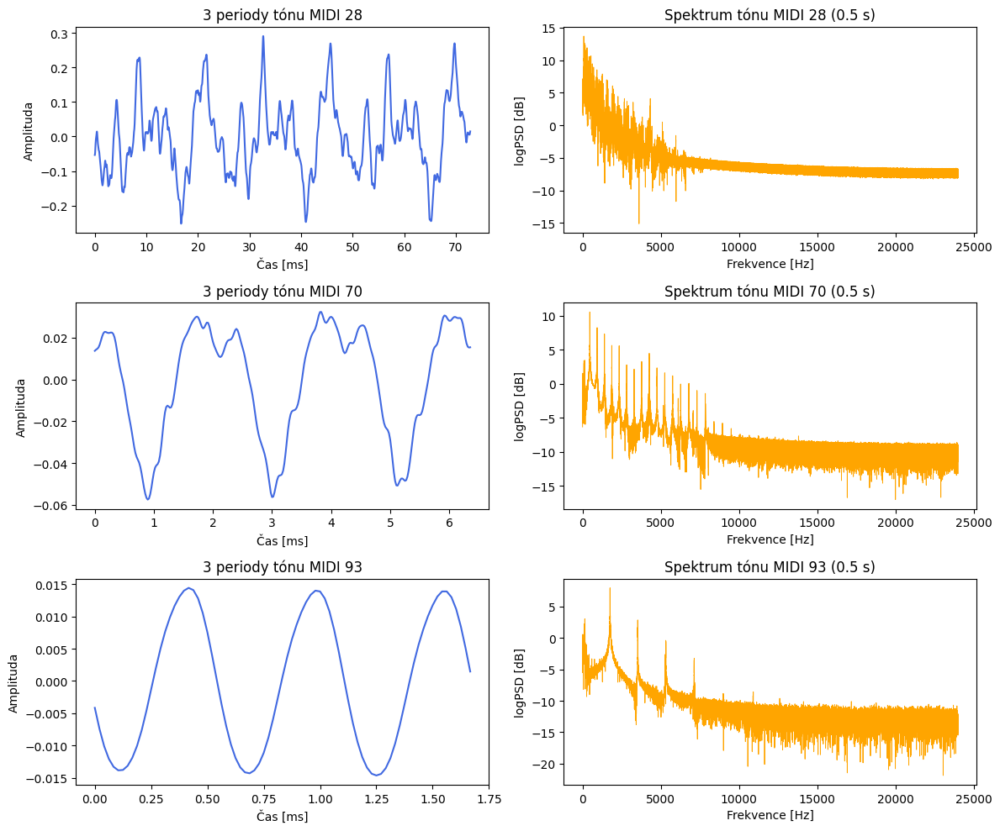

In [2]:
# F_s is sampling frequency of original_signal
# original_signal is array of floats
original_signal, F_s = sf.read('klavir.wav')

F_s # sampling frequency
T_s = 1/F_s # sampling period

tone_len = F_s*2 # length of one tone in number of samples = 2 seconds
length = len(original_signal) # length of original_signal in number of samples

# get half second of each tone
tones = {}

# load all notes (array is empty from 0 to 23)
# but we can index array by MIDI tone
for i in range(midi_low, midi_high+1):
    # get start and end of 0.5 s of tone in samples
    tone_start = (i-midi_low)*tone_len + tone_len//8
    tone_end = tone_start + tone_len//4
    
    # tones contains 0.5 s of each tone
    tones[i] = original_signal[tone_start:tone_end]

fig = plt.figure(figsize=(12, 10))

i = 0
for tone in my_tones:
    my_tone = tones[tone]    
    # save to file
    file_name = "../audio/" + chr(i+97) + "_orig.wav"
    sf.write(file_name, my_tone, F_s)
    
    # plot 3 periods of tone
    # calculate length of one period in tone
    period = int(F_s/midi_freqs[tone])
    
    graph = fig.add_subplot(3, 2, (2*i)+1)
    graph.set_title("3 periody tónu MIDI " + str(tone))
    graph.set_xlabel("Čas [ms]")
    graph.set_ylabel("Amplituda")
    
    # x-axis is time in miliseconds (range from 0 to 3 periods)
    graph_range = np.arange(0,(3*period/F_s*1000),step=1/F_s*1000)
    graph.plot(graph_range, my_tone[:3*period], color='royalblue')
    
    # plot spectrum of tone
    dft = np.array(my_tone)
    # we are doing FFT on 0.5 s of tone, to get 24000 Hz spectrum we need to pad it to 1 second
    zero_padding = np.zeros(len(dft))
    dft = np.concatenate((dft, zero_padding))
    dft = np.fft.fft(dft)
    dft = np.abs(dft)

    graph = fig.add_subplot(3, 2, (2*i)+2)
    graph.set_title("Spektrum tónu MIDI " + str(tone) + " (0.5 s)")
    graph.set_xlabel("Frekvence [Hz]")
    graph.set_ylabel("logPSD [dB]")
    
    log_psd = np.log(dft**2)[:F_s//2]
    graph.plot(log_psd + 10**-5, color='orange', linewidth=0.7)
    i += 1
  
plt.tight_layout()

In [3]:
# ----------- Part 2 -------------

In [4]:
# calculate DFT and autocorrelation for each tone
# DFT fails for lower frequencies, but autocorrelation fails for higher frequencies
# we need to choose the one that is closer to the true frequency
dft = [0 for _ in range(0, midi_high + 1)]
auto = [0 for _ in range(0, midi_high + 1)]

# calculate for each tone
for i in range(midi_low, midi_high+1):
    
    # calculate autocorrelation
    auto[i] = sp.signal.correlate(tones[i], tones[i], mode='full')
    auto[i] = auto[i][len(auto[i])//2:]
    
    # calculate DFT
    # we are doing FFT on 0.5 s of tone, to get full spectrum we need to pad it to 1 second
    zero_padding = np.zeros(len(tones[i]))
    tone = np.concatenate((tones[i], zero_padding))
    dft[i] = np.fft.fft(tone)
    # we only need half of the spectrum
    dft[i] = np.abs(dft[i][:len(dft[i])//2 + 1])

In [5]:
# create arrays for data
auto_freqs = [0 for _ in range(0, midi_high + 1)]
dft_freqs  = [0 for _ in range(0, midi_high + 1)]
calculated_freqs = [0 for i in range(0, midi_high + 1)]
auto_peaks = {}

# Calculate frequencies
for i in range(midi_low, midi_high + 1):
    
    # find frequency of tone using autocorrelation
    auto_peaks[i], _ = sp.signal.find_peaks(auto[i], distance=F_s/40)
    auto_freqs[i] = F_s/auto_peaks[i][0]
    
    # find frequency of tone using DFT
    dft_freqs[i] = np.argmax(dft[i])

    # see which method is closer to the real frequency
    real_freq = midi_freqs[i]
    dft_error = round(abs((dft_freqs[i]/real_freq*100)-100), 2)
    auto_error = round(abs((auto_freqs[i]/real_freq*100)-100), 2)
    
    # print results
    print("MIDI %3s" %str(i) + ":", end="")
    print(" %7s Hz" %round(real_freq, 2), end="")
    
    print("\t\tAC:  %7s Hz\t(error = %5s%%)" %(round(auto_freqs[i], 2), str(auto_error)), end="")
    print("\t\tDFT: %7s Hz\t(error = %5s%%)" %(round(dft_freqs[i], 2), str(dft_error)))
        

for i in range(midi_low, midi_high + 1):
    if(i < 56):
        calculated_freqs[i] = auto_freqs[i]
    else:
        calculated_freqs[i] = dft_freqs[i]

MIDI  24:    32.7 Hz		AC:    32.81 Hz	(error =  0.33%)		DFT:      65 Hz	(error = 98.78%)
MIDI  25:   34.65 Hz		AC:    34.76 Hz	(error =  0.31%)		DFT:      69 Hz	(error = 99.13%)
MIDI  26:   36.71 Hz		AC:    36.84 Hz	(error =  0.35%)		DFT:      73 Hz	(error = 98.86%)
MIDI  27:   38.89 Hz		AC:    39.02 Hz	(error =  0.35%)		DFT:      78 Hz	(error = 100.57%)
MIDI  28:    41.2 Hz		AC:    41.34 Hz	(error =  0.35%)		DFT:      82 Hz	(error = 99.03%)
MIDI  29:   43.65 Hz		AC:     43.8 Hz	(error =  0.33%)		DFT:      87 Hz	(error = 99.31%)
MIDI  30:   46.25 Hz		AC:    46.42 Hz	(error =  0.37%)		DFT:      92 Hz	(error = 98.92%)
MIDI  31:    49.0 Hz		AC:    49.18 Hz	(error =  0.37%)		DFT:      98 Hz	(error = 100.0%)
MIDI  32:   51.91 Hz		AC:    52.12 Hz	(error =   0.4%)		DFT:     104 Hz	(error = 100.35%)
MIDI  33:    55.0 Hz		AC:    55.17 Hz	(error =  0.31%)		DFT:     110 Hz	(error = 100.0%)
MIDI  34:   58.27 Hz		AC:    58.47 Hz	(error =  0.34%)		DFT:     116 Hz	(error = 99.07%)
MIDI  35:   61.74 H

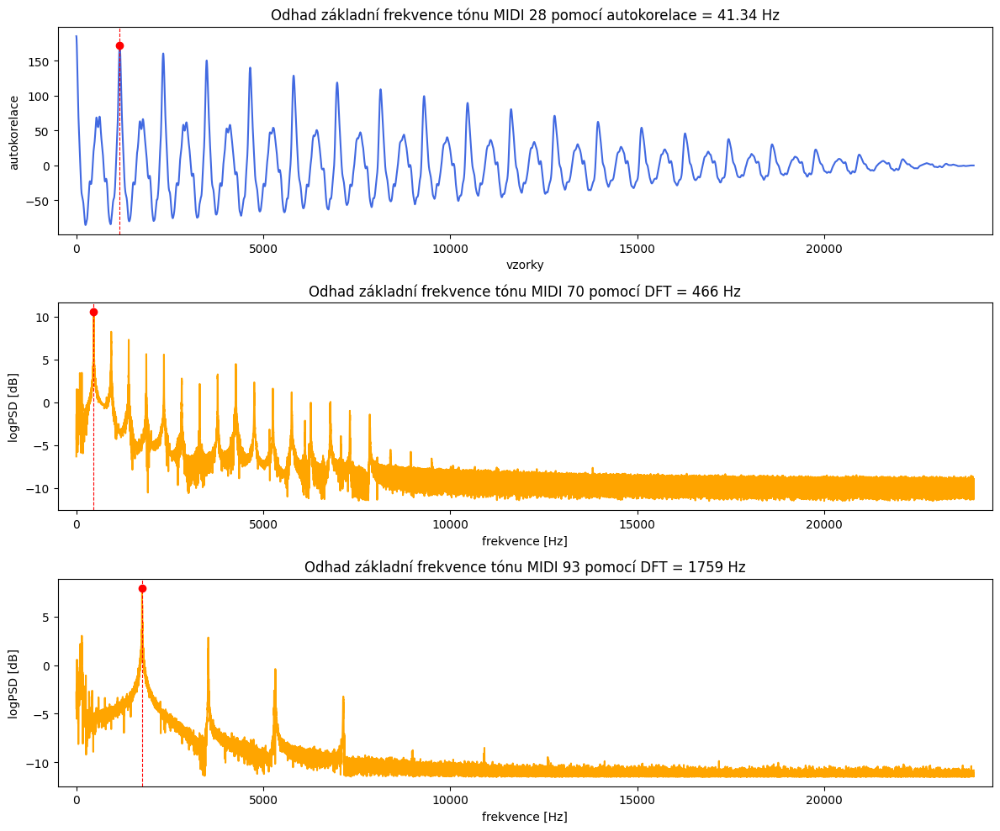

In [6]:
# plot graph with results for my tones
fig = plt.figure(figsize=(12, 10))

index = 1
for i in my_tones:
    graph = fig.add_subplot(3, 1, index)    
    # autocorrelation for lower tones
    if i < 56:
        graph.set_xlabel("vzorky")
        graph.set_ylabel("autokorelace")
        graph.title.set_text("Odhad základní frekvence tónu MIDI " + str(i) + " pomocí autokorelace = " + str(round(calculated_freqs[i], 2)) + " Hz")
        
        plot = auto[i][:F_s//2]
        graph.plot(plot, color='royalblue')
        graph.plot(auto_peaks[i][0], plot[auto_peaks[i][0]], 'o', color='red')
        graph.axvline(x=auto_peaks[i][0], color='red', linewidth=0.8, linestyle='--')
        graph.set_xlim(-500, F_s//2+500)
    
    # DFT for higher tones
    else:
        graph.set_xlabel("frekvence [Hz]")
        graph.set_ylabel("logPSD [dB]")
        graph.title.set_text("Odhad základní frekvence tónu MIDI " + str(i) + " pomocí DFT = " + str(round(calculated_freqs[i], 2)) + " Hz")
                     
        plot = np.log(dft[i]**2 + 10**-5)
        graph.plot(plot, color='orange')
        graph.plot(dft_freqs[i], plot[dft_freqs[i]], 'o', color='red')
        graph.axvline(x=dft_freqs[i], color='red', linewidth=0.8, linestyle='--')
        graph.set_xlim(-500, F_s//2+500)
        
    index += 1
    
plt.tight_layout()

In [7]:
# ----------- Part 3 -------------

In [8]:
# use DTFT to calculate base frequency of each tone more precisely

# set constants
# more points = more precise, but slower
FREQPOINTS = 500

# create arrays for data
dtft_freqs = [0 for i in range(0, midi_high + 1)] # frequencies of tones calculated using DTFT
dtft = [0 for i in range(0, midi_high + 1)]

# calculate frequencies
for i in range(midi_low, midi_high + 1):
    # optimal range is 1/10 of the frequency
    FREQRANGE = calculated_freqs[i]//10
    
    tone = tones[i]
    tone_fft = np.fft.fft(tone)
    tone_len = len(tone)
    
    arange = np.arange(0,tone_len)
    sweep = np.linspace(calculated_freqs[i]-FREQRANGE, calculated_freqs[i]+FREQRANGE,FREQPOINTS)    
    zeros = np.zeros([FREQPOINTS, tone_len],dtype=complex)   
    
    for j in np.arange(0,FREQPOINTS):
        zeros[j,:] = np.exp(-1j * 2 * np.pi * sweep[j] / F_s * arange)     # norm. omega = 2 * pi * f / Fs ... 
        
    # do the DTFT
    dtft[i] = np.matmul(zeros,tone.T)
    dtft_freqs[i] = sweep[np.argmax(np.abs(dtft[i]))]
    
    # sometimes, DTFT values are actually double than they should be
    # divide them by 2 to account for that
    if(abs(abs(dtft_freqs[i])/2 - midi_freqs[i]) < 10):
        dtft[i] = dtft[i]/2
        dtft_freqs[i] = dtft_freqs[i]/2

    # print results
    print("MIDI %3s" %str(i) + ":", end="")
    print(" %7s Hz" %midi_freqs[i], end="")
    print("\tApproax.: %6s Hz" %(round(calculated_freqs[i], 2)), end="")
    print("\tDTFT: %9s Hz" %(round(dtft_freqs[i], 4)))

MIDI  24:    32.7 Hz	Approax.:  32.81 Hz	DTFT:    32.166 Hz
MIDI  25:   34.65 Hz	Approax.:  34.76 Hz	DTFT:    32.539 Hz
MIDI  26:   36.71 Hz	Approax.:  36.84 Hz	DTFT:   36.1948 Hz
MIDI  27:   38.89 Hz	Approax.:  39.02 Hz	DTFT:    38.321 Hz
MIDI  28:    41.2 Hz	Approax.:  41.34 Hz	DTFT:   39.2355 Hz
MIDI  29:   43.65 Hz	Approax.:   43.8 Hz	DTFT:   44.3648 Hz
MIDI  30:   46.25 Hz	Approax.:  46.42 Hz	DTFT:   43.5279 Hz
MIDI  31:    49.0 Hz	Approax.:  49.18 Hz	DTFT:   46.7996 Hz
MIDI  32:   51.91 Hz	Approax.:  52.12 Hz	DTFT:   56.7165 Hz
MIDI  33:    55.0 Hz	Approax.:  55.17 Hz	DTFT:   55.5832 Hz
MIDI  34:   58.27 Hz	Approax.:  58.47 Hz	DTFT:   59.3771 Hz
MIDI  35:   61.74 Hz	Approax.:  61.94 Hz	DTFT:   61.9716 Hz
MIDI  36:   65.41 Hz	Approax.:  65.57 Hz	DTFT:   65.3453 Hz
MIDI  37:    69.3 Hz	Approax.:  69.46 Hz	DTFT:   74.9355 Hz
MIDI  38:   73.42 Hz	Approax.:  73.62 Hz	DTFT:   72.9603 Hz
MIDI  39:   77.78 Hz	Approax.:  77.92 Hz	DTFT:   77.3189 Hz
MIDI  40:   82.41 Hz	Approax.:  82.62 Hz

In [9]:
# ----------- Part 4 -------------

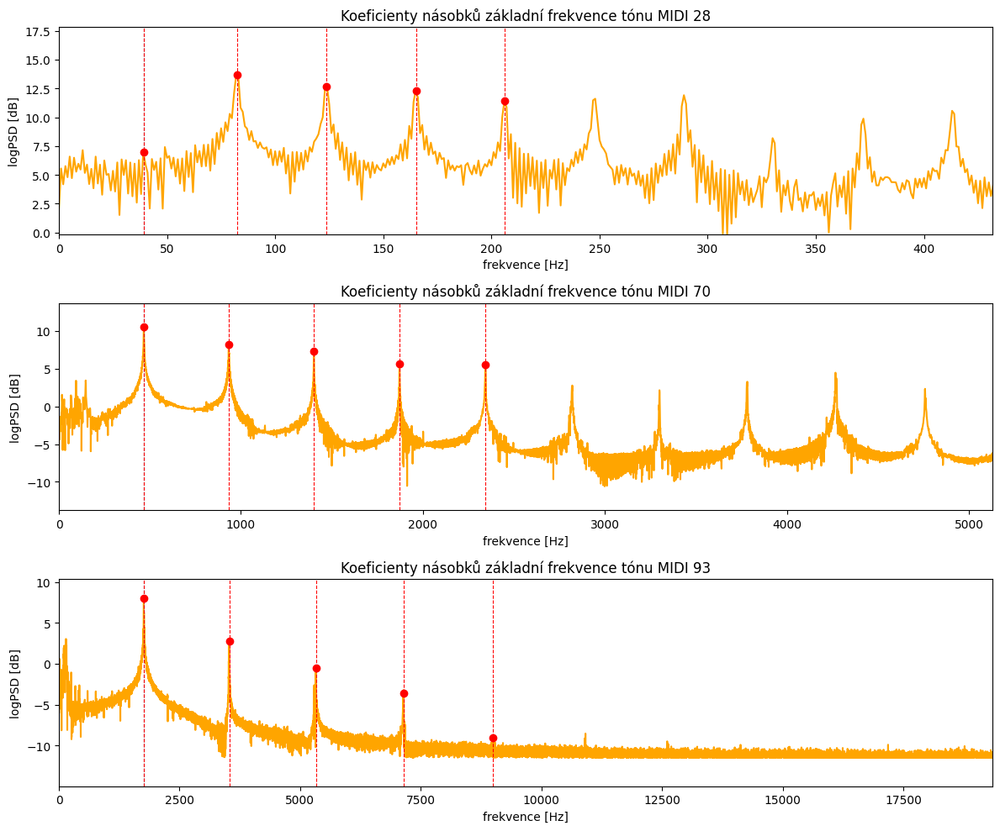

In [10]:
# representation of a piano
# represent each tone as an array of 10 float numbers
# in my case, i am using 5 modules and phases

# tone is 0.5 seconds long sound
# freq is the base frequency of the tone
def do_dtft(tone, freq):
    FREQRANGE = freq//10
    
    # do the DTFT
    tone_fft = np.fft.fft(tone)
    tone_len = len(tone)
    arange = np.arange(0,tone_len)
    sweep = np.linspace(freq-FREQRANGE, freq+FREQRANGE,FREQPOINTS)    
    zeros = np.zeros([FREQPOINTS, tone_len],dtype=complex)   

    for j in np.arange(0,FREQPOINTS):
        zeros[j,:] = np.exp(-1j * 2 * np.pi * sweep[j] / F_s * arange)     # norm. omega = 2 * pi * f / Fs ... 
        
    result_dtft = np.matmul(zeros,tone.T)
    freq = sweep[np.argmax(np.abs(result_dtft))]
    
    # calculate module and phase
    module = np.max(np.abs(result_dtft))
    phase = np.angle(result_dtft[np.argmax(abs(result_dtft))]) 
    
    # return[0] is more precise frequency
    # return[1] is tuple of (module, phase)
    return freq, (module, phase)

# number of tones
num = 5

# float_tones contains 2 floats for each tone
# [0] - module, [1] - phase
float_tone = [(0.0, 0.0) for _ in range(0, num)]
base_freq_multiples = [0.0 for _ in range(0, num)]

# stores all float_tones for each tone
float_tones_arr = {}
base_freq_multiples_arr = {}

fig = plt.figure(figsize=(12, 10))
plot_index = 1

for tone in range(midi_low, midi_high + 1):

    # do DTFT for base frequency    
    base_freq_multiples[0], float_tone[0] = do_dtft(tones[tone], dtft_freqs[tone])
    # calculate multiples of base frequency
    for j in range (1, num):
        base_freq_multiples[j] = base_freq_multiples[0] * (j+1)

    # go through all multiples of base frequency
    for i in range(1, num):
        # do DTFT to precisely calculate frequency
        base_freq_multiples[i], float_tone[i] = do_dtft(tones[tone], base_freq_multiples[i])
        # recalculate multiples of base frequency
        for j in range (i+1, num):
            base_freq_multiples[j] = base_freq_multiples[i]/(i+1) * (j+1)
    
    # save results
    float_tones_arr[tone] = float_tone.copy()
    base_freq_multiples_arr[tone] = base_freq_multiples.copy()
    
    # plot my tones
    if (my_tones.__contains__(tone)):
        graph = fig.add_subplot(3, 1, plot_index)
        
        plot = np.log(dft[tone]**2 + 10**-5)
        graph.plot(plot, color='orange')

        graph.axvline(x=base_freq_multiples[0], linewidth=0.8, linestyle='--')
        for k in range(0, num):
            graph.axvline(x=base_freq_multiples[k], color='red', linewidth=0.8, linestyle='--')
            graph.plot(base_freq_multiples[k], plot[int(np.round(base_freq_multiples[k]))], 'o', color='red')
        
        graph.set_xlabel("frekvence [Hz]")
        graph.set_ylabel("logPSD [dB]")
        graph.title.set_text("Koeficienty násobků základní frekvence tónu MIDI " + str(tone))
        
        # x-axis set from 0 to 11 times base frequency
        graph.set_xlim(0, 11*base_freq_multiples[0])
        y_min = np.min(plot[:int(11*base_freq_multiples[0])])
        y_max = np.max(plot[:int(11*base_freq_multiples[0])])
        graph.set_ylim(1.3*y_min, 1.3*y_max)
        plot_index += 1
    
plt.tight_layout()
plt.show()


In [11]:
# ----------- Part 5 -------------

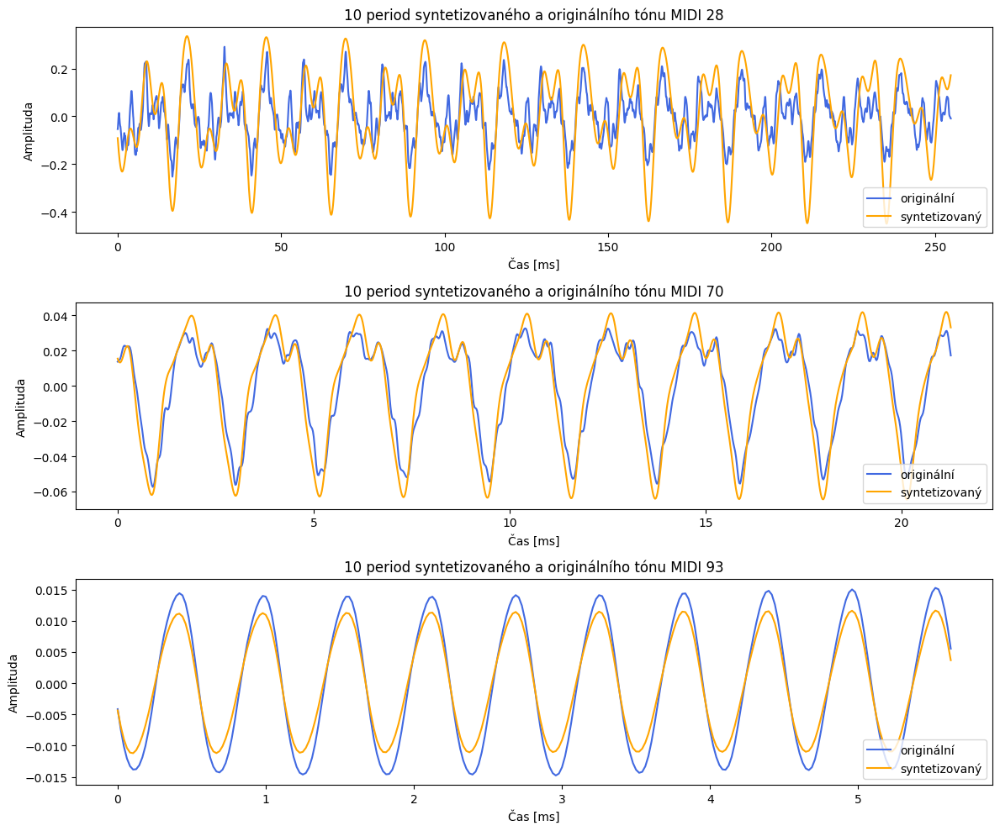

In [12]:
# synthetize tones that we stored in float_tones_arr
# I am using inverse DFT
# TODO: fix amplitude for each tone

synth_tones = {}

for i in range(midi_low, midi_high + 1):
    # load tone and its DFT
    tone = float_tones_arr[i]
    tone_dft = dft[i]

    # create an array that is same as DFT, but zeros
    shape = tone_dft.shape
    array = np.zeros(shape, dtype=complex)

    # fill the array with modules and phases
    # 10 times is used to make the sound closer to original
    for j in range (0, num):
        index = int(np.round(base_freq_multiples_arr[i][j]))
        array[index] = (10*tone[j][0]) * np.exp(1j * tone[j][1])

    # do inverse DFT
    tone_ifft = np.fft.ifft(array, n=F_s)
    # use only real part
    tone_ifft = np.real(tone_ifft)
    # use 0.5 seconds of the tone
    tone_ifft = tone_ifft[:int(F_s/2)]
    # that is the synthetized tone
    synth_tones[i] = tone_ifft
    
fig = plt.figure(figsize=(12, 10))
plot_index = 1

for tone in my_tones:
    # save to file
    file_name = "../audio/" + chr(plot_index-1+97) + ".wav"
    # synthetized tones are 0.5 seconds, need to repeat
    one_sec = np.tile(synth_tones[tone], 2)
    sf.write(file_name, one_sec, F_s)

    # plot
    graph = fig.add_subplot(3, 1, plot_index)
    graph.set_title("10 period syntetizovaného a originálního tónu MIDI " + str(tone))
    graph.set_xlabel("Čas [ms]")
    graph.set_ylabel("Amplituda")

    # some matplotlib magic because I don't know how to recalculate samples to miliseconds properly
    # x-axis is time in miliseconds (range from 0 to 10 periods)
    period = int(F_s/dtft_freqs[tone])
    graph_range = np.arange(0,((10*period+1)/F_s*1000),step=1/F_s*1000)
    graph.plot(graph_range, tones[tone][:(10*period)+1], color='royalblue', label="originální")
    graph.plot(graph_range, synth_tones[tone][:(10*period)+1], color='orange', label="syntetizovaný")
    graph.legend(loc='lower right')
    
    plot_index += 1
    
plt.tight_layout()
plt.show()

In [13]:
# ----------- Part 6 -------------

In [14]:
# open file with song
file = open("skladba.txt", "r")
lines = file.readlines()
song = np.zeros((len(lines), 4))

i = 0
song_length = 0
for line in lines:
    # in ms, convert to samples
    # 1000 ms = 1 s = 48000 samples
    # 1 ms = 48 samples
    song[i][0] = float(line.split()[0])*48
    song[i][1] = float(line.split()[1])*48
    if(song[i][1] > song_length):
        song_length = song[i][1]
    song[i][2] = line.split()[2]
    song[i][3] = line.split()[3]
    i += 1
    
# create empty arrays for 48k and 8k, add buffer to end
rate_48k = 48000
result_48k = np.zeros(int(np.ceil(song_length))+rate_48k)

rate_8k = 8000
coeff = rate_48k//rate_8k
result_8k = np.zeros((int(song_length)//coeff)+rate_8k)

# go through each instruction in song
for data in song:
    from_samples = int(data[0])
    to_samples = int(data[1])
    midi_tone = int(data[2])
    volume = data[3]
    
    tone_duration = to_samples - from_samples
    tone = synth_tones[midi_tone]
    tone_length = len(tone)
    # volume is coefficient
    volume = volume/100
    
    # tone might be shorter than duration, so we need to repeat it enough times
    resized_tone = np.tile(tone, int(np.ceil(tone_duration/tone_length)))

    # add tone to result, multiply by volume
    result_48k[from_samples:to_samples] += resized_tone[:tone_duration]*volume

# generate 8k audio - only store every (48/8) sample from the 48k audio
for i in range(0, len(result_48k)):
    if(i % coeff == 0 and i//coeff < len(result_8k)):
        result_8k[i//coeff] = result_48k[i]
    
display(Audio(result_48k, rate=rate_48k))
display(Audio(result_8k, rate=rate_8k))

# save to file
sf.write("../audio/out_48k.wav", result_48k[0:10*rate_48k], rate_48k)
sf.write("../audio/out_8k.wav", result_8k[0:10*rate_8k], rate_8k)


In [15]:
# ----------- Part 7 -------------

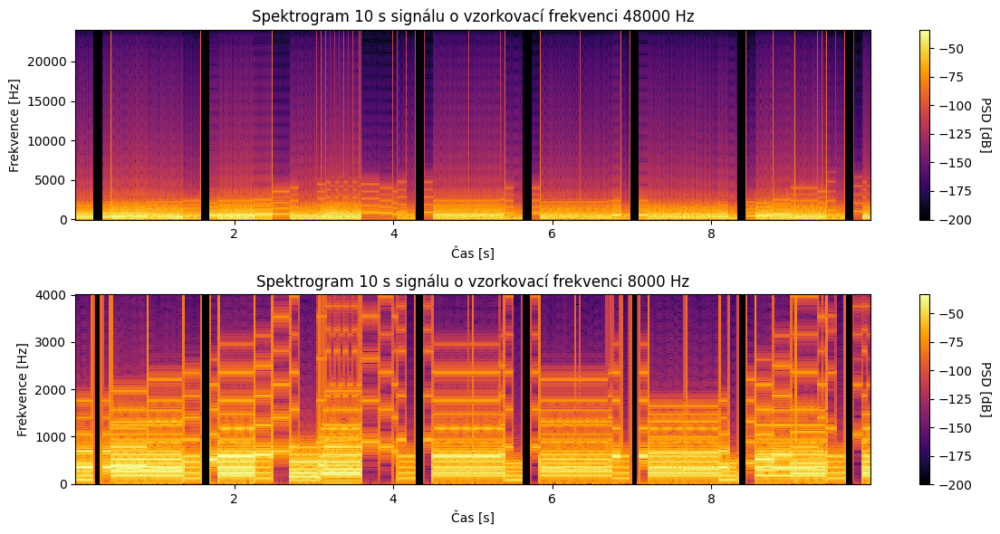

In [16]:
# display spectrogram of 10 seconds of both 48k and 8k audio

result_48k_10s = result_48k[:rate_48k*10]
num_samples_48k = 2048
result_8k_10s = result_8k[:rate_8k*10]
num_samples_8k = 512

fig = plt.figure(figsize=(12, 6))

f, t, sgr = sp.signal.spectrogram(result_48k_10s, rate_48k, nfft=num_samples_48k)
sgr_log = 10 * np.log10(sgr+1e-20) 

plt.subplot(2, 1, 1)
plt.title("Spektrogram 10 s signálu o vzorkovací frekvenci 48000 Hz")
plt.pcolormesh(t,f,sgr_log)
plt.set_cmap('inferno')
plt.gca().set_xlabel('Čas [s]')
plt.gca().set_ylabel('Frekvence [Hz]')
cbar = plt.colorbar()
cbar.set_label('PSD [dB]', rotation=270, labelpad=15)

f, t, sgr = sp.signal.spectrogram(result_8k_10s, rate_8k, nfft=num_samples_8k)
sgr_log = 10 * np.log10(sgr+1e-20) 

plt.subplot(2, 1, 2)
plt.title("Spektrogram 10 s signálu o vzorkovací frekvenci 8000 Hz")
plt.pcolormesh(t,f,sgr_log)
plt.set_cmap('inferno')
plt.gca().set_xlabel('Čas [s]')
plt.gca().set_ylabel('Frekvence [Hz]')
cbar = plt.colorbar()
cbar.set_label('PSD [dB]', rotation=270, labelpad=15)


plt.tight_layout()

display(Audio(result_48k_10s, rate=rate_48k))
display(Audio(result_8k_10s, rate=rate_8k))
